# INNOVA HACKHATHON
### Rana Feyza ÖZKAN

# 1. Veri Ön İşleme

## 1.1 Gerekli Kütüphanelerin ve Datasetin Yüklenmesi

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from prophet import Prophet
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
from sklearn.cluster import KMeans
from statsmodels.tsa.seasonal import seasonal_decompose

import warnings
warnings.filterwarnings('ignore')


In [2]:
data = pd.read_excel('hackathon 2024 - Yapay Zeka.xlsx')

## 1.2 Dataset Prepreation 

##### Verisetinin ilk ve son 3 satırı aşağıda gösterildi.

In [3]:
data.head(3)

,TIME_STAMP,SERVER_NAME,DOWNLOAD,UPLOAD
0,2024-03-05 18:25:00,10.0.901.xx Server 1,11927.017,424.700
1,2024-03-05 18:20:00,10.0.901.xx Server 1,19703.467,525.575
2,2024-03-05 18:15:00,10.0.901.xx Server 1,26349.663,631.144


In [4]:
data.tail(3)

,TIME_STAMP,SERVER_NAME,DOWNLOAD,UPLOAD
35426,2023-11-02 10:20:00,10.0.901.xx Server 1,14381.373,357.816
35427,2023-11-02 10:15:00,10.0.901.xx Server 1,14336.298,355.811
35428,2023-11-02 10:10:00,10.0.901.xx Server 1,14611.335,357.395


##### Aşağıda TIME_STAMP columnu Dtype olarak datetime'a çevirildi.

In [5]:
data['TIME_STAMP'] = pd.to_datetime(data['TIME_STAMP'])

In [6]:
data.shape

(35429, 4)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35429 entries, 0 to 35428
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   TIME_STAMP   35429 non-null  datetime64[ns]
 1   SERVER_NAME  35429 non-null  object        
 2   DOWNLOAD     35427 non-null  float64       
 3   UPLOAD       35427 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 1.1+ MB


In [8]:
data.describe()

,TIME_STAMP,DOWNLOAD,UPLOAD
count,35429,35427.000000,35427.000000
mean,2024-01-03 13:59:16.925117696,19052.251090,482.140941
min,2023-11-02 10:10:00,2335.885000,57.749000
25%,2023-12-03 12:05:00,11342.646000,264.406500
50%,2024-01-03 13:55:00,18816.920000,475.543000
75%,2024-02-03 15:45:00,26627.177000,668.998000
max,2024-03-05 18:25:00,43930.614000,1670.995000
std,NaN,10213.032412,267.930799


In [9]:
data.head().style.set_properties(subset=['TIME_STAMP'], **{'background-color': 'cyan'})

,TIME_STAMP,SERVER_NAME,DOWNLOAD,UPLOAD
0,2024-03-05 18:25:00,10.0.901.xx Server 1,11927.017000,424.700000
1,2024-03-05 18:20:00,10.0.901.xx Server 1,19703.467000,525.575000
2,2024-03-05 18:15:00,10.0.901.xx Server 1,26349.663000,631.144000
3,2024-03-05 18:10:00,10.0.901.xx Server 1,26068.494000,623.673000
4,2024-03-05 18:05:00,10.0.901.xx Server 1,25814.357000,620.701000


## 1.3 Dataset Cleaning

##### Duplicated Rowslerı tespit etme çalışması yaptım. Herhangi tekrar eden column bulamadım.

In [10]:
duplicate_rows = data.duplicated()
print("Number of duplicate rows:", duplicate_rows.sum())

Number of duplicate rows: 0


##### Veri temizlme aşamısında bir sonraki aşamada null valueları buldum. Download ve Upload da 2 tane boş value var.

In [11]:
data.isna().sum()

TIME_STAMP     0
SERVER_NAME    0
DOWNLOAD       2
UPLOAD         2
dtype: int64

In [12]:
data['DOWNLOAD'] = data['DOWNLOAD'].fillna(data['DOWNLOAD'].mean())
data['UPLOAD'] = data['UPLOAD'].fillna(data['UPLOAD'].mean())

##### Server Name de sadece 1 tane instance olduğu için modelime herhangi bir etkisi bulunmadı.

In [13]:
data['SERVER_NAME'].unique()

array(['10.0.901.xx Server 1'], dtype=object)

In [14]:
data.drop(columns=['SERVER_NAME'], inplace=True)

In [15]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35429 entries, 0 to 35428
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   TIME_STAMP  35429 non-null  datetime64[ns]
 1   DOWNLOAD    35429 non-null  float64       
 2   UPLOAD      35429 non-null  float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 830.5 KB


In [60]:
df = data.copy()
df_1 = data.copy()
df_2 = data.copy()
df_3 = data.copy()
# her bir soru için ayrı datasetler oluşturdum

## 1.4 Data Manipulation

##### SORU 3 için dataframi daha ayrıntılı hale getiriyorum

In [17]:
df_3['HOUR'] = df_3['TIME_STAMP'].dt.hour
df_3['MINUTE'] = df_3['TIME_STAMP'].dt.minute
df_3['WEEKDAY'] = df_3['TIME_STAMP'].dt.weekday
df_3['IS_WEEKEND'] = df_3['WEEKDAY'].apply(lambda x: 1 if x >= 5 else 0)

# is_weekend = haftasonumu değil mi. Eğer 1 ise evet 0 ise hayır

Soru 2 

In [18]:
holiday = ['2024-01-01']
df_3['IS_HOLIDAY'] = df_3['TIME_STAMP'].dt.strftime('%Y-%m-%d').isin(holiday).astype(int) 

In [19]:
df_3.head()

,TIME_STAMP,DOWNLOAD,UPLOAD,HOUR,MINUTE,WEEKDAY,IS_WEEKEND,IS_HOLIDAY
0,2024-03-05 18:25:00,11927.017,424.700,18,25,1,0,0
1,2024-03-05 18:20:00,19703.467,525.575,18,20,1,0,0
2,2024-03-05 18:15:00,26349.663,631.144,18,15,1,0,0
3,2024-03-05 18:10:00,26068.494,623.673,18,10,1,0,0
4,2024-03-05 18:05:00,25814.357,620.701,18,5,1,0,0


aynı null value doldurma işlemimi 2. soru için olan dataset için uyguluyorum

In [20]:
features = df_3[['DOWNLOAD', 'UPLOAD', 'WEEKDAY', 'HOUR', 'MINUTE','IS_WEEKEND','IS_HOLIDAY']]

## 1.5 Data Visualization

### 1.5.1 Ortalama Upload ve Download (Holiday ve Non-Holiday)

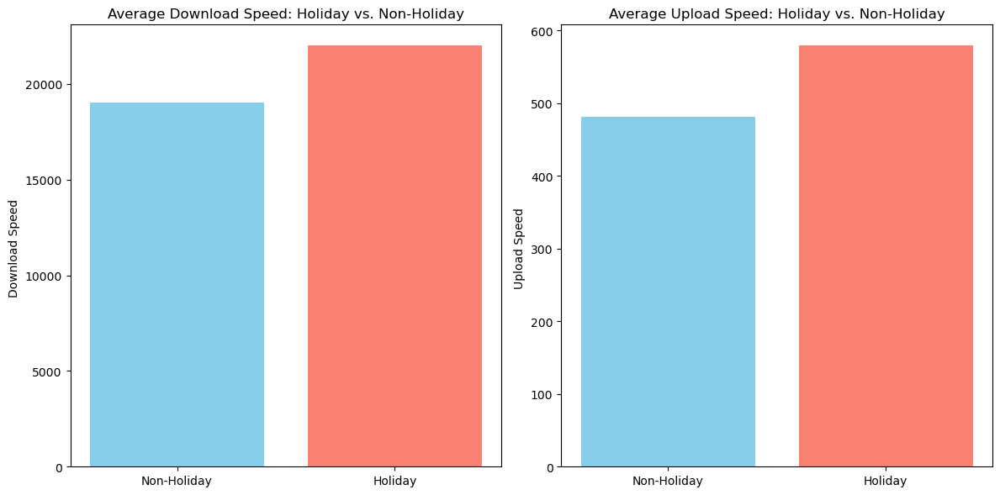

In [21]:
holiday_vs_non_holiday = df_3.groupby('IS_HOLIDAY')[['DOWNLOAD', 'UPLOAD']].mean().reset_index()
holiday_vs_non_holiday['IS_HOLIDAY'] = holiday_vs_non_holiday['IS_HOLIDAY'].replace({0: 'Non-Holiday', 1: 'Holiday'})

fig, ax = plt.subplots(1, 2, figsize=(12, 6))

ax[0].bar(holiday_vs_non_holiday['IS_HOLIDAY'], holiday_vs_non_holiday['DOWNLOAD'], color=['skyblue', 'salmon'])
ax[0].set_title('Average Download Speed: Holiday vs. Non-Holiday')
ax[0].set_ylabel('Download Speed ')

ax[1].bar(holiday_vs_non_holiday['IS_HOLIDAY'], holiday_vs_non_holiday['UPLOAD'], color=['skyblue', 'salmon'])
ax[1].set_title('Average Upload Speed: Holiday vs. Non-Holiday')
ax[1].set_ylabel('Upload Speed ')

plt.tight_layout()
plt.show()

### 1.5.2 Upload ve Download Time Serisi

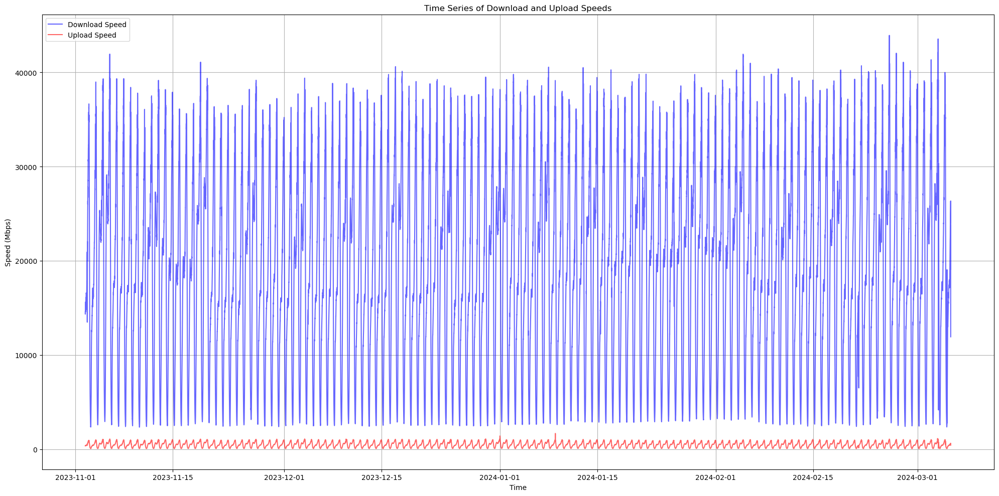

In [22]:
plt.figure(figsize=(20, 10))

plt.plot(df_3['TIME_STAMP'], df_3['DOWNLOAD'], label='Download Speed', color='blue', alpha=0.6)
plt.plot(df_3['TIME_STAMP'], df_3['UPLOAD'], label='Upload Speed', color='red', alpha=0.6)

plt.title('Time Series of Download and Upload Speeds')
plt.xlabel('Time')
plt.ylabel('Speed (Mbps)')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

### 1.5.3 Haftasonları

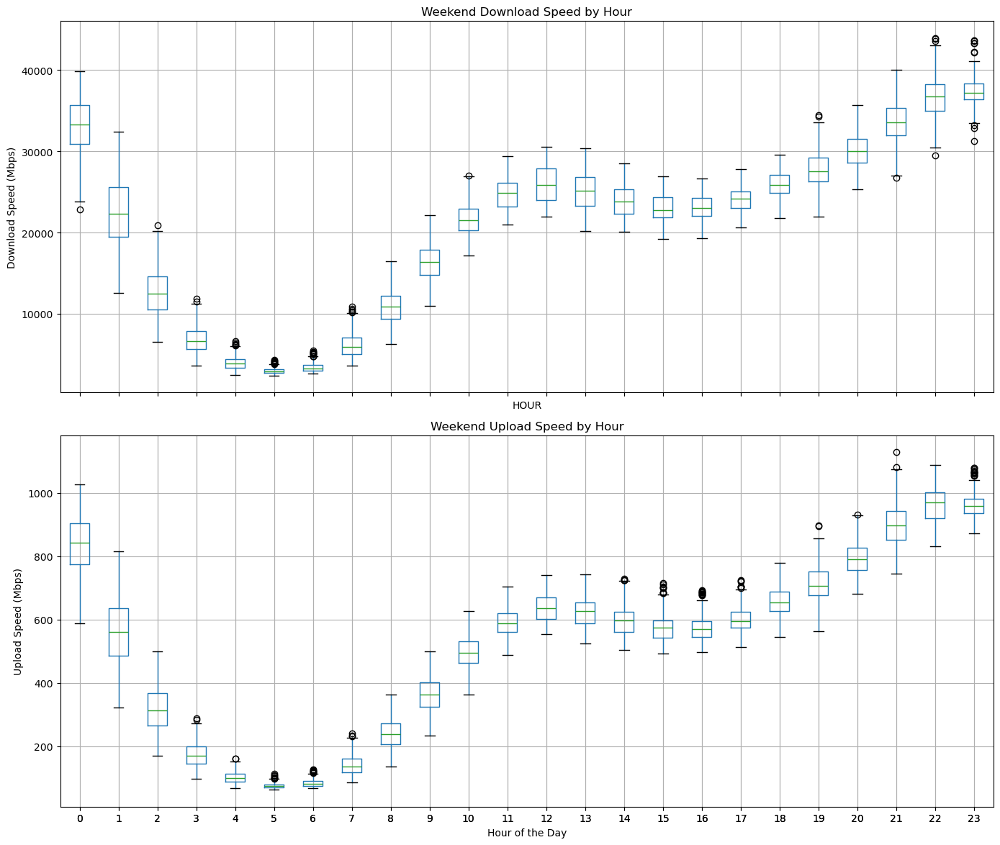

In [23]:
weekends = df_3[df_3['IS_WEEKEND'] == 1]

fig, ax = plt.subplots(2, 1, figsize=(14, 12), sharex=True)

weekends.boxplot(column='DOWNLOAD', by='HOUR', ax=ax[0], grid=True)
ax[0].set_title('Weekend Download Speed by Hour')
ax[0].set_ylabel('Download Speed (Mbps)')

weekends.boxplot(column='UPLOAD', by='HOUR', ax=ax[1], grid=True)
ax[1].set_title('Weekend Upload Speed by Hour')
ax[1].set_ylabel('Upload Speed (Mbps)')
ax[1].set_xlabel('Hour of the Day')

plt.suptitle('')
plt.tight_layout()

plt.show()


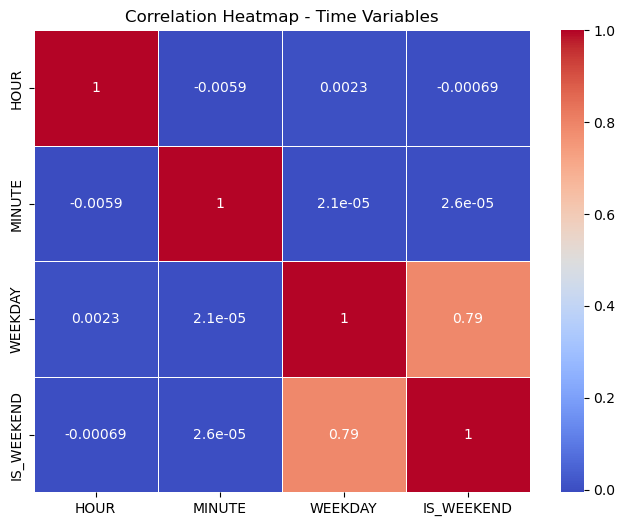

In [24]:
time_correlation_matrix = df_3[['HOUR', 'MINUTE', 'WEEKDAY', 'IS_WEEKEND']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(time_correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap - Time Variables')
plt.show()


# 2. Anomali Tespiti Anomali Tespit Algoritması İle (Soru 1)

## 2.1 Isolation Forest Zaman Verileri ile birlikte

In [25]:
features = df_3[['DOWNLOAD', 'UPLOAD', 'WEEKDAY', 'HOUR', 'MINUTE','IS_WEEKEND','IS_HOLIDAY']]


In [26]:
model_if = IsolationForest(contamination=0.01, random_state=42)
anomalies = model_if.fit_predict(features)

In [27]:
df_if = df_3.copy()
df_if['ANOMALY'] = anomalies
df_if.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35429 entries, 0 to 35428
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   TIME_STAMP  35429 non-null  datetime64[ns]
 1   DOWNLOAD    35429 non-null  float64       
 2   UPLOAD      35429 non-null  float64       
 3   HOUR        35429 non-null  int32         
 4   MINUTE      35429 non-null  int32         
 5   WEEKDAY     35429 non-null  int32         
 6   IS_WEEKEND  35429 non-null  int64         
 7   IS_HOLIDAY  35429 non-null  int64         
 8   ANOMALY     35429 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int32(3), int64(3)
memory usage: 2.0 MB


In [28]:
df_if.head()


,TIME_STAMP,DOWNLOAD,UPLOAD,HOUR,MINUTE,WEEKDAY,IS_WEEKEND,IS_HOLIDAY,ANOMALY
0,2024-03-05 18:25:00,11927.017,424.700,18,25,1,0,0,1
1,2024-03-05 18:20:00,19703.467,525.575,18,20,1,0,0,1
2,2024-03-05 18:15:00,26349.663,631.144,18,15,1,0,0,1
3,2024-03-05 18:10:00,26068.494,623.673,18,10,1,0,0,1
4,2024-03-05 18:05:00,25814.357,620.701,18,5,1,0,0,1


In [29]:
df_if['ANOMALY'].unique()

array([ 1, -1])

In [30]:
new_data = pd.DataFrame({
    'TIME_STAMP': [pd.to_datetime('2024-03-05 18:25:00')],
    'DOWNLOAD': [11927.017],
    'UPLOAD': [424.7],
    'HOUR':18,
    'MINUTE':[25],
    'WEEKDAY':[1],
    'IS_WEEKEND':[0],
    'IS_HOLIDAY':[0],
})

In [31]:
new_data['anomaly_score'] = model_if.predict(new_data[['DOWNLOAD', 'UPLOAD', 'WEEKDAY', 'HOUR', 'MINUTE','IS_WEEKEND','IS_HOLIDAY']])
new_data['is_anomaly'] = new_data['anomaly_score'] == -1

print(new_data)

           TIME_STAMP   DOWNLOAD  UPLOAD  HOUR  MINUTE  WEEKDAY  IS_WEEKEND  \
0 2024-03-05 18:25:00  11927.017   424.7    18      25        1           0   

   IS_HOLIDAY  ANOMALY  anomaly_score  is_anomaly  
0           0        1              1       False  


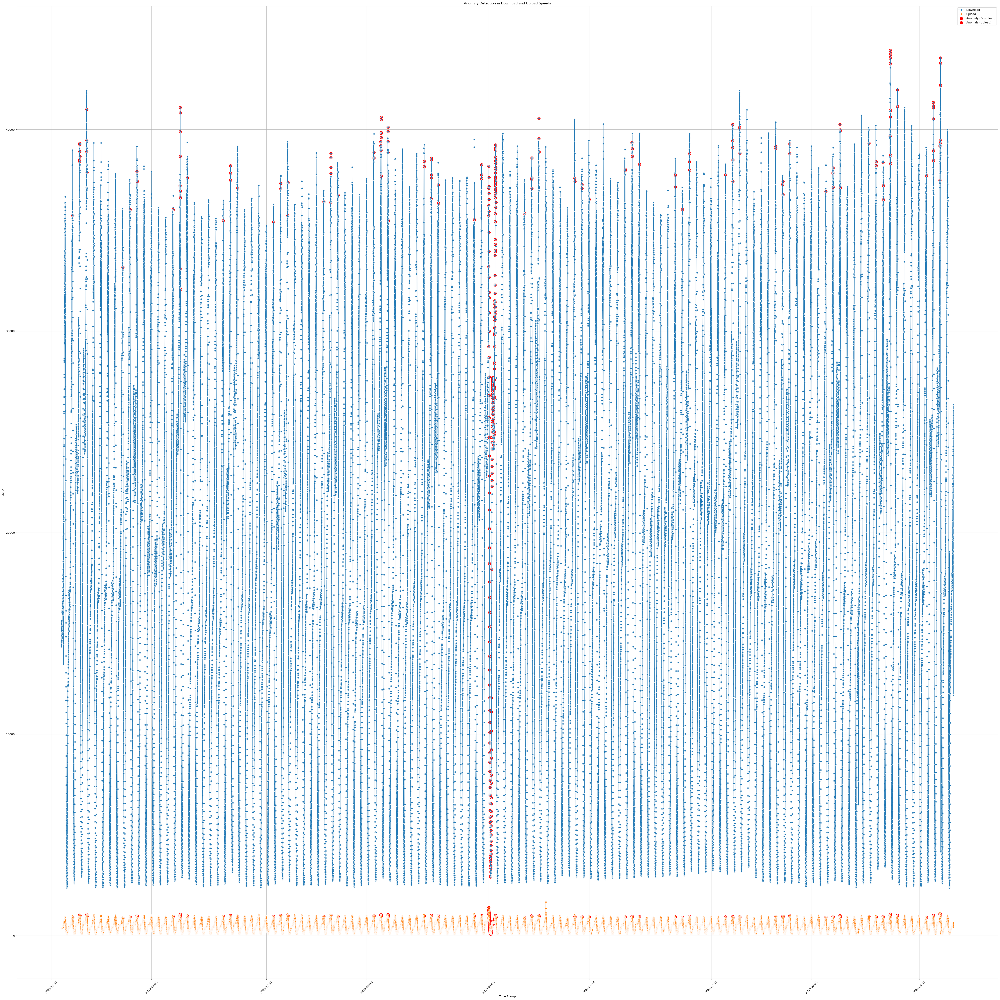

In [32]:
plt.figure(figsize=(50, 50))

sns.lineplot(x='TIME_STAMP', y='DOWNLOAD', data=df_if, label='Download', marker='o')
sns.lineplot(x='TIME_STAMP', y='UPLOAD', data=df_if, label='Upload', marker='o')

anomalies = df_if[df_if['ANOMALY'] == -1]
plt.scatter(anomalies['TIME_STAMP'], anomalies['DOWNLOAD'], color='red', s=100, label='Anomaly (Download)')
plt.scatter(anomalies['TIME_STAMP'], anomalies['UPLOAD'], color='red', s=100, label='Anomaly (Upload)')

plt.xlabel('Time Stamp');
plt.ylabel('Value')
plt.title('Anomaly Detection in Download and Upload Speeds')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

### 2.1.2 Visuzalization - Isolation Forest Makine Öğrenmesi Modelinin Uygulanması

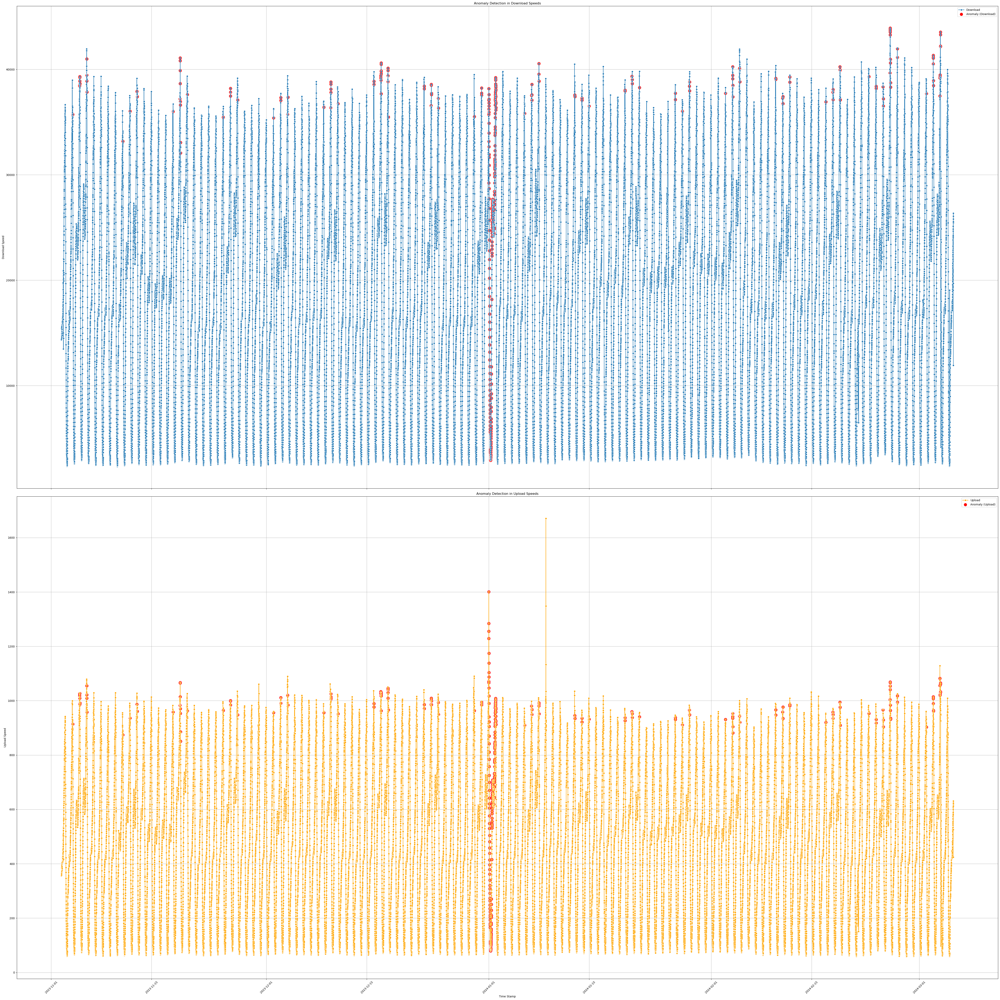

In [33]:
fig, ax = plt.subplots(2, 1, figsize=(50, 50), sharex=True)

sns.lineplot(x='TIME_STAMP', y='DOWNLOAD', data=df_if, label='Download', marker='o', ax=ax[0])
anomalies_download = df_if[df_if['ANOMALY'] == -1]
ax[0].scatter(anomalies_download['TIME_STAMP'], anomalies_download['DOWNLOAD'], color='red', s=100, label='Anomaly (Download)')
ax[0].set_ylabel('Download Speed')
ax[0].set_title('Anomaly Detection in Download Speeds')
ax[0].legend()
ax[0].grid(True)

sns.lineplot(x='TIME_STAMP', y='UPLOAD', data=df_if, label='Upload', marker='o', ax=ax[1],color='orange')
anomalies_upload = df_if[df_if['ANOMALY'] == -1]
ax[1].scatter(anomalies_upload['TIME_STAMP'], anomalies_upload['UPLOAD'], color='red', s=100, label='Anomaly (Upload)')
ax[1].set_xlabel('Time Stamp')
ax[1].set_ylabel('Upload Speed')
ax[1].set_title('Anomaly Detection in Upload Speeds')
ax[1].legend()
ax[1].grid(True)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## 2.2 Isolation Forest Seasonal Decompose

In [65]:

decompose_result = seasonal_decompose(df['DOWNLOAD'], period=1)
df['TREND'] = decompose_result.trend
df['SEASONAL'] = decompose_result.seasonal
df['RESIDUAL'] = decompose_result.resid

df.dropna(inplace=True)  

print(df[['DOWNLOAD', 'TREND', 'SEASONAL', 'RESIDUAL']])

model = IsolationForest(contamination=0.1, random_state=42)
features = ['TREND', 'RESIDUAL']
X = df[features]

df['ANOMALY_SCORE'] = model.fit_predict(X)
df['ANOMALY'] = df['ANOMALY_SCORE'] == -1

print(df[['DOWNLOAD', 'TREND', 'RESIDUAL', 'ANOMALY']])


                      DOWNLOAD      TREND  SEASONAL  RESIDUAL
TIME_STAMP                                                   
2024-03-05 18:25:00  11927.017  11927.017       0.0       0.0
2024-03-05 18:20:00  19703.467  19703.467       0.0       0.0
2024-03-05 18:15:00  26349.663  26349.663       0.0       0.0
2024-03-05 18:10:00  26068.494  26068.494       0.0       0.0
2024-03-05 18:05:00  25814.357  25814.357       0.0       0.0
...                        ...        ...       ...       ...
2023-11-02 10:30:00  14604.990  14604.990       0.0       0.0
2023-11-02 10:25:00  14461.797  14461.797       0.0       0.0
2023-11-02 10:20:00  14381.373  14381.373       0.0       0.0
2023-11-02 10:15:00  14336.298  14336.298       0.0       0.0
2023-11-02 10:10:00  14611.335  14611.335       0.0       0.0

[35429 rows x 4 columns]
                      DOWNLOAD      TREND  RESIDUAL  ANOMALY
TIME_STAMP                                                  
2024-03-05 18:25:00  11927.017  11927.017     

In [70]:

decompose_result = seasonal_decompose(df['UPLOAD'], period=1)
df['TREND'] = decompose_result.trend
df['SEASONAL'] = decompose_result.seasonal
df['RESIDUAL'] = decompose_result.resid

df.dropna(inplace=True)  

print(df[['UPLOAD', 'TREND', 'SEASONAL', 'RESIDUAL']])

model = IsolationForest(contamination=0.1, random_state=42)
features = ['TREND', 'RESIDUAL']
X = df[features]

df['ANOMALY_SCORE'] = model.fit_predict(X)
df['ANOMALY'] = df['ANOMALY_SCORE'] == -1

print(df[['DOWNLOAD', 'TREND', 'RESIDUAL', 'ANOMALY']])

                      UPLOAD    TREND  SEASONAL  RESIDUAL
TIME_STAMP                                               
2024-03-05 18:25:00  424.700  424.700       0.0       0.0
2024-03-05 18:20:00  525.575  525.575       0.0       0.0
2024-03-05 18:15:00  631.144  631.144       0.0       0.0
2024-03-05 18:10:00  623.673  623.673       0.0       0.0
2024-03-05 18:05:00  620.701  620.701       0.0       0.0
...                      ...      ...       ...       ...
2023-11-02 10:30:00  364.365  364.365       0.0       0.0
2023-11-02 10:25:00  358.717  358.717       0.0       0.0
2023-11-02 10:20:00  357.816  357.816       0.0       0.0
2023-11-02 10:15:00  355.811  355.811       0.0       0.0
2023-11-02 10:10:00  357.395  357.395       0.0       0.0

[35429 rows x 4 columns]
                      DOWNLOAD    TREND  RESIDUAL  ANOMALY
TIME_STAMP                                                
2024-03-05 18:25:00  11927.017  424.700       0.0    False
2024-03-05 18:20:00  19703.467  525.575    

TRUE FALSE İLE BİRLŞETİR

In [68]:
df['ANOMALY_SCORE_UPLOAD'] = model_upload.fit_predict(X_upload)
df['ANOMALY_UPLOAD'] = df['ANOMALY_SCORE_UPLOAD'] == -1

df['ANOMALY'] = ((df['ANOMALY_DOWNLOAD']) | (df['ANOMALY_UPLOAD'])).astype(int)


print(df[['DOWNLOAD', 'UPLOAD', 'TREND_DOWNLOAD', 'RESIDUAL_DOWNLOAD', 'TREND_UPLOAD', 'RESIDUAL_UPLOAD', 'ANOMALY']])


AttributeError: 'Prophet' object has no attribute 'fit_predict'

Zamanım yetmediği için yukarıdaki kodu sonlandıramadım.

## 2.3 Isolation Forest Seasonal Decompose with hour/minute/day

In [34]:
df_1['WEEKDAY'] = df_1['TIME_STAMP'].dt.weekday
df_1['HOUR'] = df_1['TIME_STAMP'].dt.hour
df_1['MINUTE'] = df_1['TIME_STAMP'].dt.minute
df_1['DAY_OF_YEAR'] = df_1['TIME_STAMP'].dt.dayofyear

holidays = ['2024-01-01']
df_1['HOLIDAY'] = df_2['TIME_STAMP'].dt.strftime('%Y-%m-%d').isin(holidays).astype(int)

df_1.head()

,TIME_STAMP,DOWNLOAD,UPLOAD,WEEKDAY,HOUR,MINUTE,DAY_OF_YEAR,HOLIDAY
0,2024-03-05 18:25:00,11927.017,424.700,1,18,25,65,0
1,2024-03-05 18:20:00,19703.467,525.575,1,18,20,65,0
2,2024-03-05 18:15:00,26349.663,631.144,1,18,15,65,0
3,2024-03-05 18:10:00,26068.494,623.673,1,18,10,65,0
4,2024-03-05 18:05:00,25814.357,620.701,1,18,5,65,0


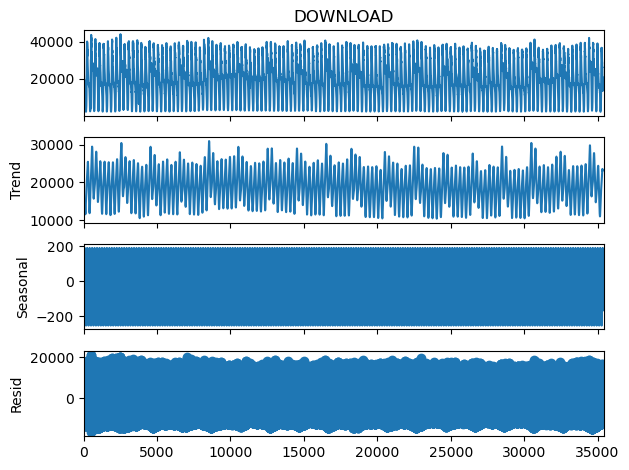

In [63]:
result = seasonal_decompose(df_1['DOWNLOAD'], model='additive', period=24*7)

result.plot()
plt.show()

residuals = result.resid.dropna()
df_1['RESIDUALS'] = residuals

# 3. Time Series Forecasting ile Anomali Bulma Çalışması (Soru 2 )

## 3.1 Prophet

### 3.1.1 Prophetin Uygulanması

In [36]:
df_2.head()

,TIME_STAMP,DOWNLOAD,UPLOAD
0,2024-03-05 18:25:00,11927.017,424.700
1,2024-03-05 18:20:00,19703.467,525.575
2,2024-03-05 18:15:00,26349.663,631.144
3,2024-03-05 18:10:00,26068.494,623.673
4,2024-03-05 18:05:00,25814.357,620.701


In [37]:
df_prophet_download = df_2[['TIME_STAMP', 'DOWNLOAD']].rename(columns={'TIME_STAMP': 'ds', 'DOWNLOAD': 'y'})
df_prophet_download

,ds,y
0,2024-03-05 18:25:00,11927.017
1,2024-03-05 18:20:00,19703.467
2,2024-03-05 18:15:00,26349.663
3,2024-03-05 18:10:00,26068.494
4,2024-03-05 18:05:00,25814.357
...,...,...
35424,2023-11-02 10:30:00,14604.990
35425,2023-11-02 10:25:00,14461.797
35426,2023-11-02 10:20:00,14381.373
35427,2023-11-02 10:15:00,14336.298


In [38]:
df_prophet_upload =  df_2[['TIME_STAMP', 'UPLOAD']].rename(columns={'TIME_STAMP': 'ds', 'UPLOAD': 'y'})
df_prophet_upload

,ds,y
0,2024-03-05 18:25:00,424.700
1,2024-03-05 18:20:00,525.575
2,2024-03-05 18:15:00,631.144
3,2024-03-05 18:10:00,623.673
4,2024-03-05 18:05:00,620.701
...,...,...
35424,2023-11-02 10:30:00,364.365
35425,2023-11-02 10:25:00,358.717
35426,2023-11-02 10:20:00,357.816
35427,2023-11-02 10:15:00,355.811


13:59:02 - cmdstanpy - INFO - Chain [1] start processing
13:59:07 - cmdstanpy - INFO - Chain [1] done processing
13:59:08 - cmdstanpy - INFO - Chain [1] start processing
13:59:15 - cmdstanpy - INFO - Chain [1] done processing


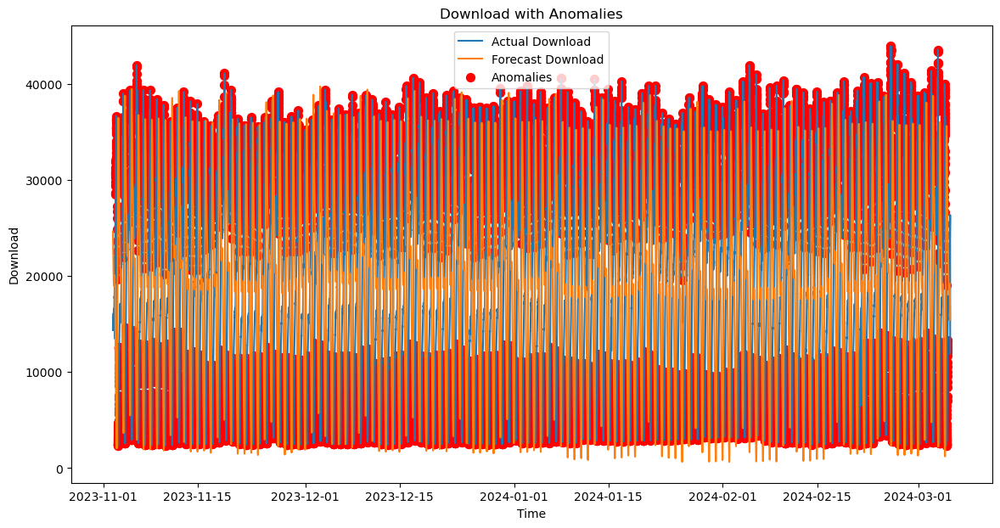

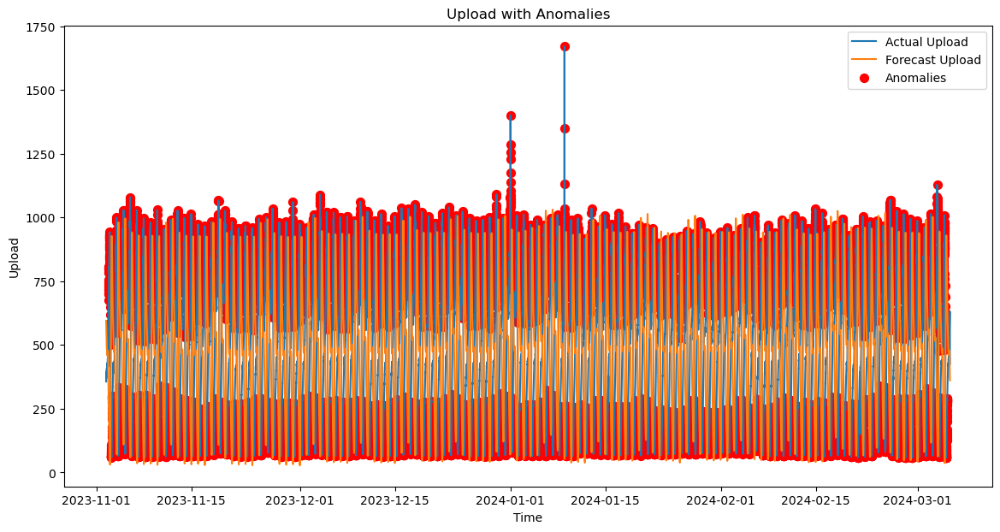

Anomalies in Download:
                       ds          y          yhat  anomaly
121   2024-03-05 08:15:00  13303.606  28645.536943  Anomaly
122   2024-03-05 08:05:00  13259.048  28945.699077  Anomaly
123   2024-03-05 08:00:00  13212.884  29251.507010  Anomaly
124   2024-03-05 07:55:00  12926.207  29562.293041  Anomaly
125   2024-03-05 07:50:00  12799.988  29877.303849  Anomaly
...                   ...        ...           ...      ...
35313 2023-11-02 19:50:00  29816.311  11523.896064  Anomaly
35314 2023-11-02 19:45:00  29431.372  11796.863196  Anomaly
35315 2023-11-02 19:40:00  28624.145  12072.605165  Anomaly
35316 2023-11-02 19:35:00  28469.581  12350.895721  Anomaly
35317 2023-11-02 19:30:00  28550.445  12631.465662  Anomaly

[16781 rows x 4 columns]
Anomalies in Upload:
                       ds        y        yhat  anomaly
114   2024-03-05 08:50:00  285.331  693.713071  Anomaly
115   2024-03-05 08:45:00  281.017  701.485759  Anomaly
116   2024-03-05 08:40:00  278.595  709.44

In [39]:
model_download = Prophet()
model_download.fit(df_prophet_download)

model_upload = Prophet()
model_upload.fit(df_prophet_upload)

future_download = model_download.make_future_dataframe(periods=10, freq='H')
forecast_download = model_download.predict(future_download)

future_upload = model_upload.make_future_dataframe(periods=10, freq='H')
forecast_upload = model_upload.predict(future_upload)

df_prophet_download['yhat'] = forecast_download['yhat'][:len(df_prophet_download)]
df_prophet_upload['yhat'] = forecast_upload['yhat'][:len(df_prophet_upload)]

threshold_download = 1.5 * df_2['DOWNLOAD'].std()
threshold_upload = 1.5 * df_2['UPLOAD'].std()

df_prophet_download['anomaly'] = abs(df_prophet_download['y'] - df_prophet_download['yhat']) > threshold_download
df_prophet_upload['anomaly'] = abs(df_prophet_upload['y'] - df_prophet_upload['yhat']) > threshold_upload

df_prophet_download['anomaly'] = df_prophet_download['anomaly'].apply(lambda x: 'Anomaly' if x else 'Normal')
df_prophet_upload['anomaly'] = df_prophet_upload['anomaly'].apply(lambda x: 'Anomaly' if x else 'Normal')

plt.figure(figsize=(14, 7))
plt.plot(df_prophet_download['ds'], df_prophet_download['y'], label='Actual Download')
plt.plot(df_prophet_download['ds'], df_prophet_download['yhat'], label='Forecast Download')
plt.scatter(df_prophet_download[df_prophet_download['anomaly'] == 'Anomaly']['ds'], 
            df_prophet_download[df_prophet_download['anomaly'] == 'Anomaly']['y'], 
            color='red', label='Anomalies', s=50)
plt.title('Download with Anomalies')
plt.xlabel('Time')
plt.ylabel('Download')
plt.legend()
plt.show()

plt.figure(figsize=(14, 7))
plt.plot(df_prophet_upload['ds'], df_prophet_upload['y'], label='Actual Upload')
plt.plot(df_prophet_upload['ds'], df_prophet_upload['yhat'], label='Forecast Upload')
plt.scatter(df_prophet_upload[df_prophet_upload['anomaly'] == 'Anomaly']['ds'], 
            df_prophet_upload[df_prophet_upload['anomaly'] == 'Anomaly']['y'], 
            color='red', label='Anomalies', s=50)
plt.title('Upload with Anomalies')
plt.xlabel('Time')
plt.ylabel('Upload')
plt.legend()
plt.show()

print('Anomalies in Download:')
print(df_prophet_download[df_prophet_download['anomaly'] == 'Anomaly'])

print('Anomalies in Upload:')
print(df_prophet_upload[df_prophet_upload['anomaly'] == 'Anomaly'])

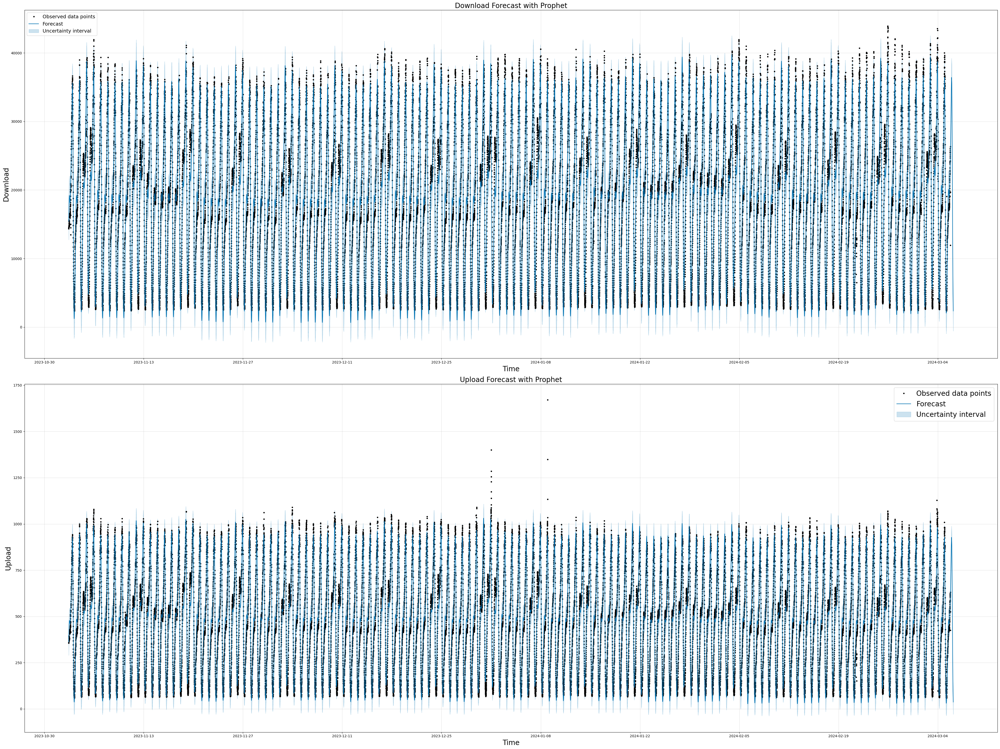

In [40]:
fig, axs = plt.subplots(2, 1, figsize=(40, 30))  

model_download.plot(forecast_download, ax=axs[0])
axs[0].set_title('Download Forecast with Prophet', fontsize=20)
axs[0].set_xlabel('Time', fontsize=20)
axs[0].set_ylabel('Download', fontsize=20)
axs[0].legend(fontsize=14)  #

model_upload.plot(forecast_upload, ax=axs[1])
axs[1].set_title('Upload Forecast with Prophet', fontsize=20)
axs[1].set_xlabel('Time', fontsize=20)
axs[1].set_ylabel('Upload', fontsize=20)
axs[1].legend(fontsize=20)  

plt.tight_layout()
plt.show()

In [41]:
df_prophet_download.head()

,ds,y,yhat,anomaly
0,2024-03-05 18:25:00,11927.017,15435.974109,Normal
1,2024-03-05 18:20:00,19703.467,15698.785948,Normal
2,2024-03-05 18:15:00,26349.663,15955.899572,Normal
3,2024-03-05 18:10:00,26068.494,16206.674710,Normal
4,2024-03-05 18:05:00,25814.357,16450.482549,Normal


In [42]:
df_prophet_upload.head()

,ds,y,yhat,anomaly
0,2024-03-05 18:25:00,424.700,361.381411,Normal
1,2024-03-05 18:20:00,525.575,368.616287,Normal
2,2024-03-05 18:15:00,631.144,375.736090,Normal
3,2024-03-05 18:10:00,623.673,382.722965,Normal
4,2024-03-05 18:05:00,620.701,389.559343,Normal


In [43]:
# Belirli Bir aralık tahmini - 1 hafta

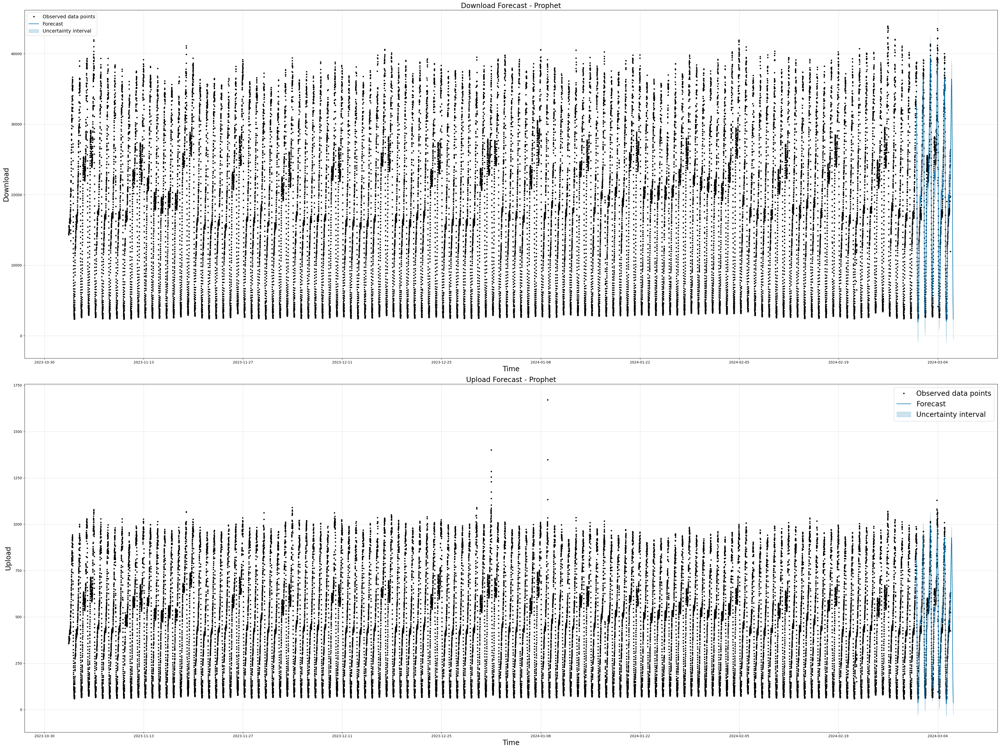

In [44]:
start_date = '2024-03-01'  
end_date = '2024-03-14'    

filtered_forecast_download = forecast_download[(forecast_download['ds'] >= start_date) & (forecast_download['ds'] <= end_date)]
filtered_forecast_upload = forecast_upload[(forecast_upload['ds'] >= start_date) & (forecast_upload['ds'] <= end_date)]

fig, axs = plt.subplots(2, 1, figsize=(40, 30))

model_download.plot(filtered_forecast_download, ax=axs[0])
axs[0].set_title('Download Forecast - Prophet', fontsize=20)
axs[0].set_xlabel('Time', fontsize=20)
axs[0].set_ylabel('Download', fontsize=20)
axs[0].legend(fontsize=14)

model_upload.plot(filtered_forecast_upload, ax=axs[1])
axs[1].set_title('Upload Forecast - Prophet', fontsize=20)
axs[1].set_xlabel('Time', fontsize=20)
axs[1].set_ylabel('Upload', fontsize=20)
axs[1].legend(fontsize=20)

plt.tight_layout()
plt.show()

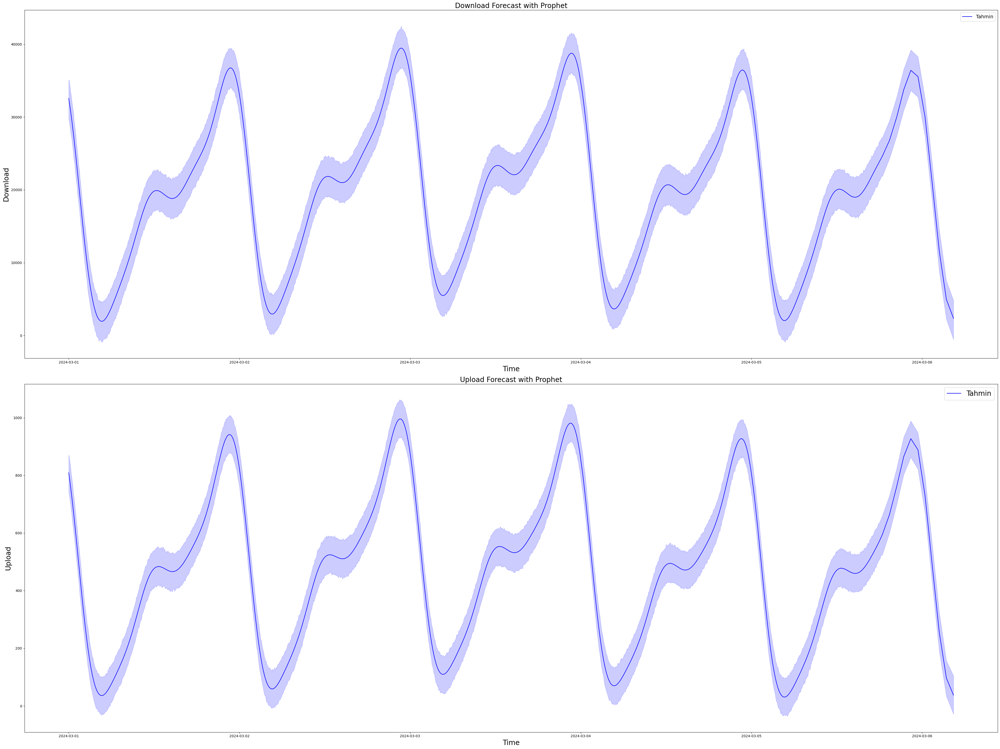

In [45]:

forecast_start_date = '2024-03-01'  
forecast_end_date = '2024-03-14'    

filtered_forecast_download = forecast_download[(forecast_download['ds'] >= forecast_start_date) & (forecast_download['ds'] <= forecast_end_date)]
filtered_forecast_upload = forecast_upload[(forecast_upload['ds'] >= forecast_start_date) & (forecast_upload['ds'] <= forecast_end_date)]

fig, axs = plt.subplots(2, 1, figsize=(40, 30))

axs[0].plot(filtered_forecast_download['ds'], filtered_forecast_download['yhat'], label='Tahmin', color='blue')
axs[0].fill_between(filtered_forecast_download['ds'], filtered_forecast_download['yhat_lower'], filtered_forecast_download['yhat_upper'], color='blue', alpha=0.2)
axs[0].set_title('Download Forecast with Prophet', fontsize=20)
axs[0].set_xlabel('Time', fontsize=20)
axs[0].set_ylabel('Download', fontsize=20)
axs[0].legend(fontsize=14)

axs[1].plot(filtered_forecast_upload['ds'], filtered_forecast_upload['yhat'], label='Tahmin', color='blue')
axs[1].fill_between(filtered_forecast_upload['ds'], filtered_forecast_upload['yhat_lower'], filtered_forecast_upload['yhat_upper'], color='blue', alpha=0.2)
axs[1].set_title('Upload Forecast with Prophet', fontsize=20)
axs[1].set_xlabel('Time', fontsize=20)
axs[1].set_ylabel('Upload', fontsize=20)
axs[1].legend(fontsize=20)

# Düzeni ayarla
plt.tight_layout()
plt.show()


In [47]:
df_2['anomaly'] = ((df_prophet_upload['anomaly'] == 1) | (df_prophet_download['anomaly'] == 1)).astype(int) 


In [48]:
df_2.head()

,TIME_STAMP,DOWNLOAD,UPLOAD,anomaly
0,2024-03-05 18:25:00,11927.017,424.700,0
1,2024-03-05 18:20:00,19703.467,525.575,0
2,2024-03-05 18:15:00,26349.663,631.144,0
3,2024-03-05 18:10:00,26068.494,623.673,0
4,2024-03-05 18:05:00,25814.357,620.701,0


# 4. Server 2 / Server 1'in en yoğun olduğu saatler (Bonus Soru)

## 4.1 Upload ve Download (Ayrı)

In [49]:
df_3.head()

,TIME_STAMP,DOWNLOAD,UPLOAD,HOUR,MINUTE,WEEKDAY,IS_WEEKEND,IS_HOLIDAY
0,2024-03-05 18:25:00,11927.017,424.700,18,25,1,0,0
1,2024-03-05 18:20:00,19703.467,525.575,18,20,1,0,0
2,2024-03-05 18:15:00,26349.663,631.144,18,15,1,0,0
3,2024-03-05 18:10:00,26068.494,623.673,18,10,1,0,0
4,2024-03-05 18:05:00,25814.357,620.701,18,5,1,0,0


In [50]:
saatlik__trafik = df_3.groupby('HOUR').agg({'DOWNLOAD': 'mean', 'UPLOAD': 'mean'}).reset_index()

In [51]:
en_yoğun_saat_download = saatlik__trafik.sort_values(by='DOWNLOAD', ascending=False).head()
en_yoğun_saat_upload = saatlik__trafik.sort_values(by='UPLOAD', ascending=False).head()

print("En yoğun saatler (DOWNLOAD):")
print(en_yoğun_saat_download)
print("\nEn yoğun saatler (UPLOAD):")
print(en_yoğun_saat_upload)



En yoğun saatler (DOWNLOAD):
    HOUR      DOWNLOAD      UPLOAD
23    23  36021.987919  921.975905
22    22  35938.868070  944.783802
21    21  32913.354761  878.126808
20    20  30539.754791  802.411190
0      0  30503.295930  766.183608

En yoğun saatler (UPLOAD):
    HOUR      DOWNLOAD      UPLOAD
22    22  35938.868070  944.783802
23    23  36021.987919  921.975905
21    21  32913.354761  878.126808
20    20  30539.754791  802.411190
0      0  30503.295930  766.183608


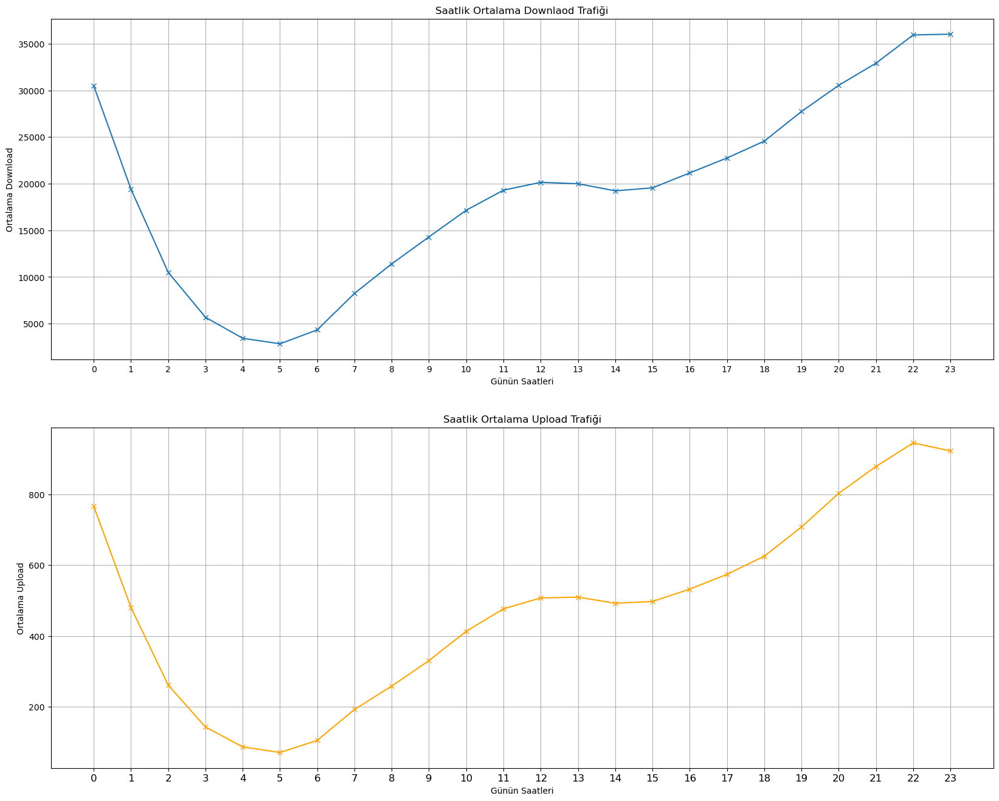

In [52]:
plt.figure(figsize=(20,16))
plt.subplot(2, 1, 1)
plt.plot(saatlik__trafik['HOUR'], saatlik__trafik['DOWNLOAD'], marker='x')
plt.title('Saatlik Ortalama Downlaod Trafiği', )
plt.xlabel('Günün Saatleri')
plt.ylabel('Ortalama Download')
plt.grid(True)
plt.xticks(np.arange(0, 24, 1))

plt.subplot(2, 1, 2)
plt.plot(saatlik__trafik['HOUR'], saatlik__trafik['UPLOAD'], marker='x', color='orange')
plt.title('Saatlik Ortalama Upload Trafiği')
plt.xlabel('Günün Saatleri')
plt.ylabel('Ortalama Upload')
plt.xticks(np.arange(0, 24, 1),fontsize=12)
plt.grid(True)
plt.show()

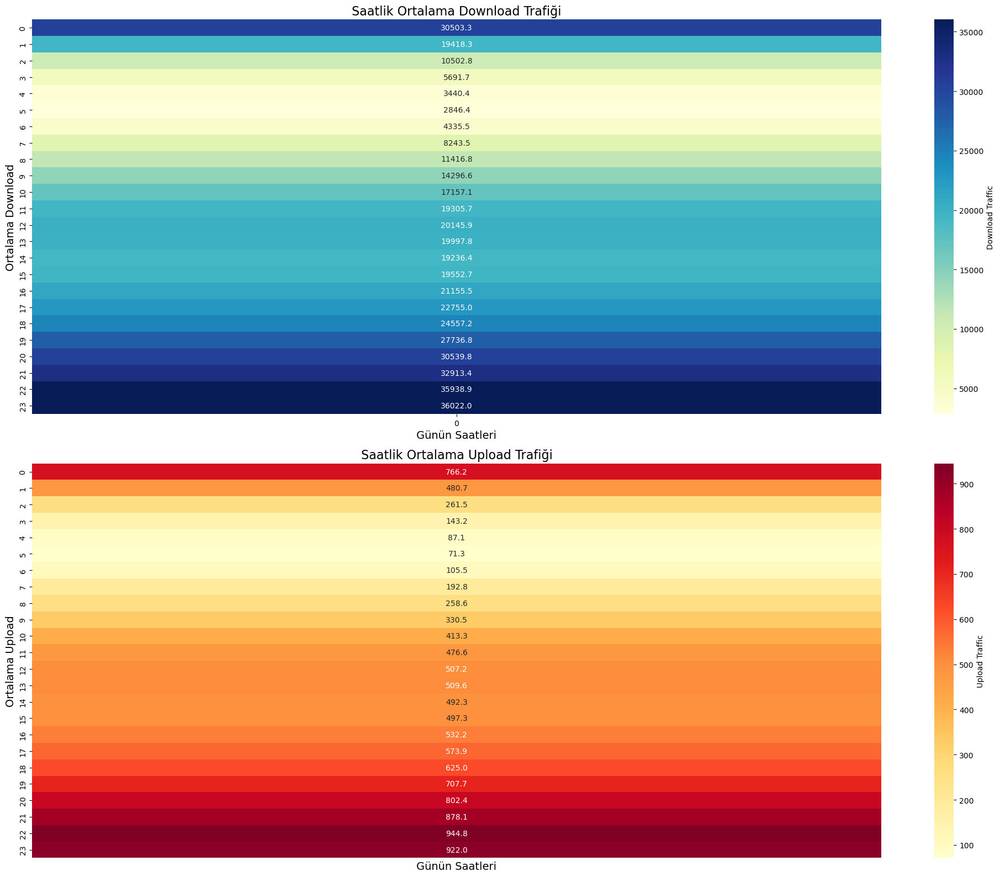

In [53]:

saatler = np.arange(24)
download_matrix = np.zeros(24)
upload_matrix = np.zeros(24)

for i in range(24):
    if i in saatlik__trafik['HOUR'].values:
        download_matrix[i] = saatlik__trafik[saatlik__trafik['HOUR'] == i]['DOWNLOAD'].values
        upload_matrix[i] = saatlik__trafik[saatlik__trafik['HOUR'] == i]['UPLOAD'].values

plt.figure(figsize=(20, 16))

plt.subplot(2, 1, 1)
sns.heatmap(download_matrix.reshape(-1, 1), annot=True, fmt=".1f", cmap="YlGnBu", cbar_kws={'label': 'Download Traffic'}, yticklabels=saatler)
plt.title('Saatlik Ortalama Download Trafiği', fontsize=16)
plt.xlabel('Günün Saatleri', fontsize=14)
plt.ylabel('Ortalama Download', fontsize=14)
 
plt.subplot(2, 1, 2)
sns.heatmap(upload_matrix.reshape(-1, 1), annot=True, fmt=".1f", cmap="YlOrRd", cbar_kws={'label': 'Upload Traffic'}, yticklabels=saatler)
plt.title('Saatlik Ortalama Upload Trafiği', fontsize=16)
plt.xlabel('Günün Saatleri', fontsize=14)
plt.ylabel('Ortalama Upload', fontsize=14)
plt.xticks([], [])  

plt.tight_layout()
plt.show()

## 4.2 Upload ve Download (Toplamı)

In [54]:
df_3['TOPLAM_TRAFİK'] = df_3['DOWNLOAD'] + df_3['UPLOAD']

In [55]:
saatlik__trafik = df_3.groupby('HOUR').agg({'TOPLAM_TRAFİK': 'mean'}).reset_index()

In [56]:
en_yoğun_saatler = saatlik__trafik.sort_values(by='TOPLAM_TRAFİK', ascending=False).head()

In [57]:
print("En yoğun saatler (TOPLAM_TRAFİK):")
print(en_yoğun_saatler)

En yoğun saatler (TOPLAM_TRAFİK):
    HOUR  TOPLAM_TRAFİK
23    23   36943.963823
22    22   36883.651872
21    21   33791.481569
20    20   31342.165981
0      0   31269.479537


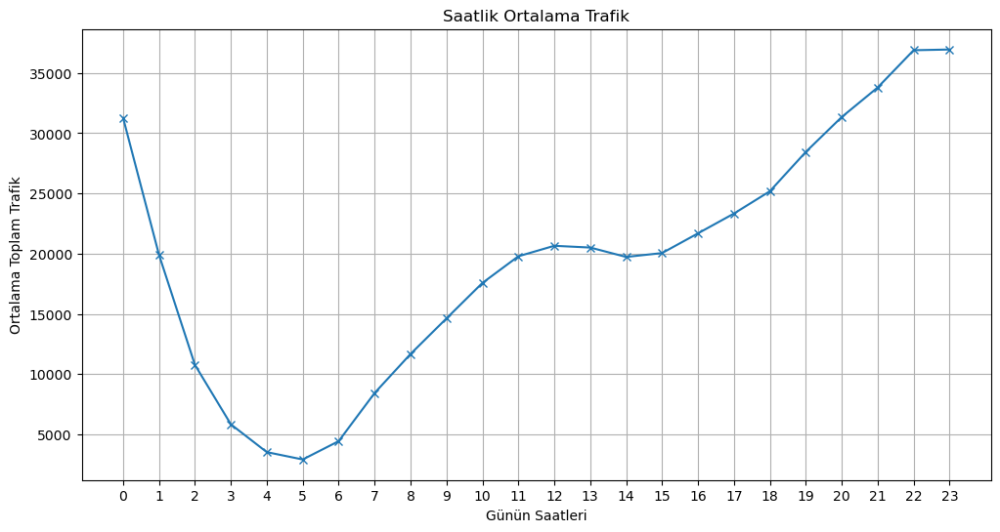

In [58]:
plt.figure(figsize=(12,6))
plt.plot(saatlik__trafik['HOUR'], saatlik__trafik['TOPLAM_TRAFİK'], marker='x')
plt.title('Saatlik Ortalama Trafik')
plt.xlabel('Günün Saatleri')
plt.ylabel('Ortalama Toplam Trafik')
plt.xticks(np.arange(0, 24, 1))
plt.grid(True)
plt.show()

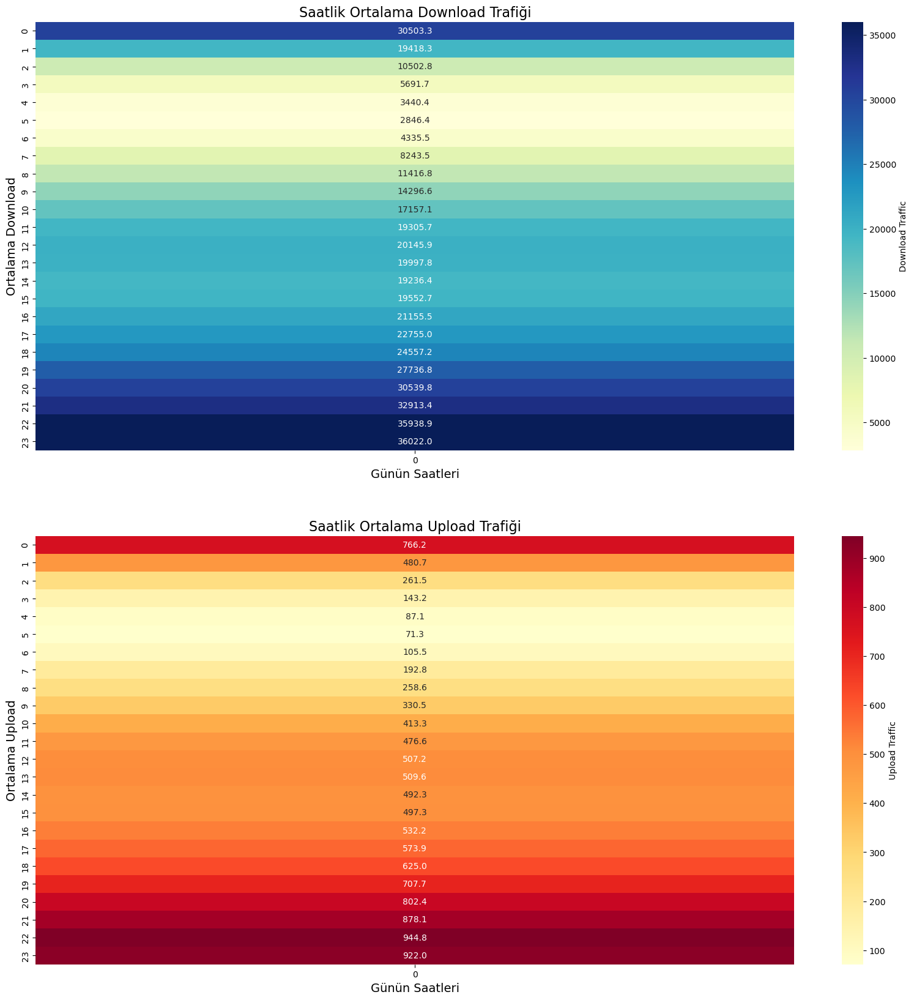

In [59]:
hourly_traffic = df_3.groupby('HOUR').agg({'DOWNLOAD': 'mean', 'UPLOAD': 'mean'}).reset_index()

hours = np.arange(24)
download_matrix = np.zeros(24)
upload_matrix = np.zeros(24)

for i in range(24):
    if i in hourly_traffic['HOUR'].values:
        download_matrix[i] = hourly_traffic[hourly_traffic['HOUR'] == i]['DOWNLOAD'].values
        upload_matrix[i] = hourly_traffic[hourly_traffic['HOUR'] == i]['UPLOAD'].values

plt.figure(figsize=(20, 20))

plt.subplot(2, 1, 1)
sns.heatmap(download_matrix.reshape(-1, 1), annot=True, fmt=".1f", cmap="YlGnBu", cbar_kws={'label': 'Download Traffic'}, yticklabels=hours)
plt.title('Saatlik Ortalama Download Trafiği', fontsize=16)
plt.xlabel('Günün Saatleri', fontsize=14)
plt.ylabel('Ortalama Download', fontsize=14)

# UPLOAD için ısı haritası
plt.subplot(2, 1, 2)
sns.heatmap(upload_matrix.reshape(-1, 1), annot=True, fmt=".1f", cmap="YlOrRd", cbar_kws={'label': 'Upload Traffic'}, yticklabels=hours)
plt.title('Saatlik Ortalama Upload Trafiği', fontsize=16)
plt.xlabel('Günün Saatleri', fontsize=14)
plt.ylabel('Ortalama Upload', fontsize=14)
plt.show()